In [1]:
import os
from PIL import Image
from PIL.ExifTags import TAGS, GPSTAGS
import matplotlib.pyplot as plt
import numpy as np

def getim_meta(X):
    info = X._getexif()
    GPSDATA = info[list(TAGS.keys())[list(TAGS.values()).index('GPSInfo')]]
    #Latitud, Longitud, Altitud
    return (GPSDATA[2][2].__float__(), GPSDATA[4][2].__float__(), GPSDATA[6].__float__())
class img_set():
    def __init__(self, path = '..\\..\\unlabeled_images'):
        self.path = path
        self.imgs_path = os.listdir(self.path)

    def __len__(self):
        return len(self.imgs_path)

    def __getitem__(self, index):
        img = self.imgs_path[index]
        X = Image.open(os.path.join(self.path, img))
        y = img
        return X, y
    
    def get_3dcoordinates(self):
        val = map(lambda i: getim_meta(self.__getitem__(i)[0]), list(range(self.__len__())))
        val = np.array(list(val))
        return val
    
    def get_2dcoordinates(self):
        val = self.get_3dcoordinates()
        plane = val[: ,:2]
        return plane
    
    def to_plot(self, MAX_X = 400):
        plane = self.get_2dcoordinates()

        return plane[:, 0], plane[:, 1]
    
    def plot(self):
        xp, yp = self.to_plot()
        return plt.scatter(xp, yp)
        
    
    



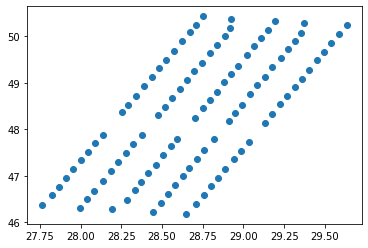

In [78]:
lab = img_set(path = '..\\..\\labeled_images')
a = lab.plot()

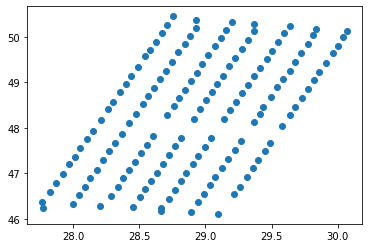

In [79]:
unlab = img_set(path = '..\\..\\unlabeled_images')
b = unlab.plot()

In [75]:
len(lab), len(unlab)

(105, 150)

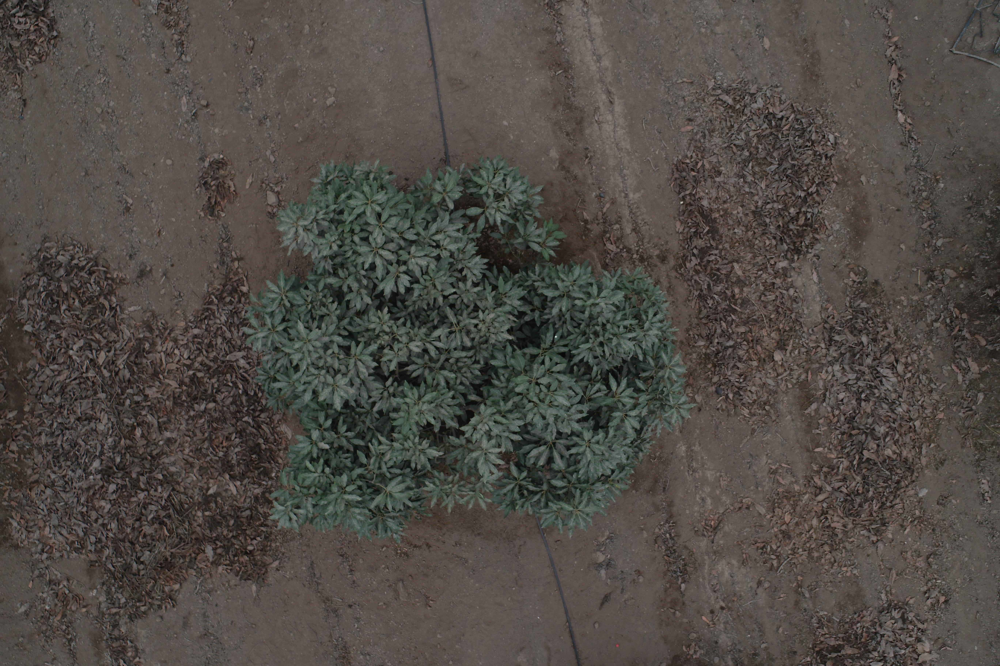

In [30]:
lab[0][0]

In [76]:
lab[0][1]

'DJI_0287_23_junio_arbol_01_fila1.JPG'

In [42]:
lab2d = lab.get_2dcoordinates()
unlab2d = unlab.get_2dcoordinates()

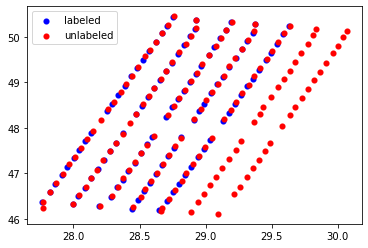

In [83]:
fig = plt.figure()
ax = fig.add_subplot(111)
x1, y1 = lab.to_plot()

x2, y2 = unlab.to_plot()
ax.scatter(x1, y1, c = 'b', linewidths=0.1, label = 'labeled')
ax.scatter(x2, y2, c = 'r', linewidths=0.1, label = 'unlabeled')
plt.legend(loc='upper left');
plt.show()

In [87]:
plane1 = lab.get_2dcoordinates()
plane2 = unlab.get_2dcoordinates()


In [90]:
plane1[0]-plane2[1]

array([-0.0037,  0.002 ])

In [91]:
plane1[1]-plane2[2]

array([-0.0023, -0.0078])

In [92]:
plane1[2]-plane2[3]

array([-0.0066, -0.0287])

In [93]:
plane1[4]-plane2[5]

array([-0.0142, -0.0533])

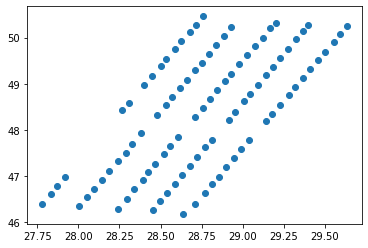

In [3]:
lab = img_set(path = '..\\..\\02_junio')
a = lab.plot()

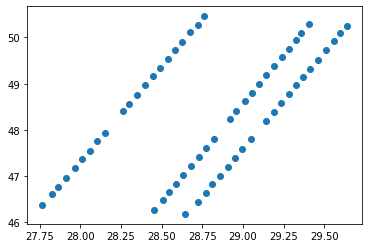

In [4]:
lab = img_set(path = '..\\..\\11_junio')
a = lab.plot()

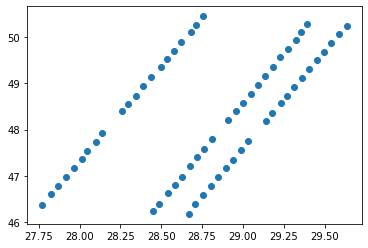

In [5]:
lab = img_set(path = '..\\..\\16_junio')
a = lab.plot()

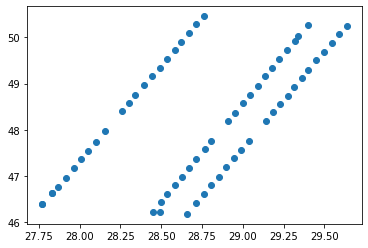

In [6]:
lab = img_set(path = '..\\..\\23_julio')
a = lab.plot()